# End-to-end Multi-class Dog Breed Classification🐶🐶

This notebook builds a end-to-end multiclass image classifier using TensorFlow 2.0 and TensorFlow Hub.

## 1. Problem
Determine what kind of dogs when dog picture is given.

## 2. Data
Get the data for dog vision from Kaggle. Here is the link:
https://www.kaggle.com/c/dog-breed-identification/overview

## 3. Evaluation
The evaluation metrics is probabilities output (multiclass output) from softmax activation.
https://www.kaggle.com/competitions/dog-breed-identification/overview/evaluation

## 4. Features
* We're using deep learning/transfer learning because it's probably best way for images (unstructured data).
* There are 120 unique kind of dogs in this data.
* There are 10,000+ images in the training set (Images with labels)
* There are around 10,000+ images in the test set (Images have no labels,

In [ ]:
# Import tensorflow and tensorflow hub into colab
import tensorflow as tf
import tensorflow_hub as hub

# Check GPU is available or no
print("GPU", "available"  if tf.config.list_physical_devices("GPU") else "not available")

GPU available


# Getting the data ready (turn into tensors)

In [ ]:
# Check our label of data
import pandas as pd

label_csv = pd.read_csv("/content/drive/MyDrive/Dog-Vision/labels.csv")
print(label_csv.describe())
print(label_csv)

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                     id                     breed
0      000bec180eb18c7604dcecc8fe0dba07               boston_bull
1      001513dfcb2ffafc82cccf4d8bbaba97                     dingo
2      001cdf01b096e06d78e9e5112d419397                  pekinese
3      00214f311d5d2247d5dfe4fe24b2303d                  bluetick
4      0021f9ceb3235effd7fcde7f7538ed62          golden_retriever
...                                 ...                       ...
10217  ffd25009d635cfd16e793503ac5edef0                    borzoi
10218  ffd3f636f7f379c51ba3648a9ff8254f            dandie_dinmont
10219  ffe2ca6c940cddfee68fa3cc6c63213f                  airedale
10220  ffe5f6d8e2bff356e9482a80a6e2

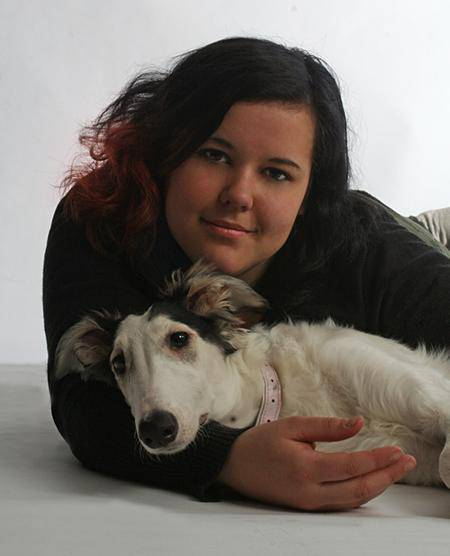

In [ ]:
# View an image
from IPython.display import Image
Image("/content/drive/MyDrive/Dog-Vision/train/ffd25009d635cfd16e793503ac5edef0.jpg")

# Get images and their labels
Get a list of all of our image pathname

In [ ]:
label_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
# Create pathanames from image id's:
filenames = ["/content/drive/MyDrive/Dog-Vision/train/" + fname + ".jpg" for fname in label_csv["id"]]

In [ ]:
# Check number of filenames matches to number of actual image files
import os
dir_len = len(os.listdir("drive/MyDrive/Dog-Vision/train/"))
if dir_len == len(filenames):
  print(f"Filenames match to directory files. Proceed, {dir_len}")
else:
  print(f"Filenames do not match actual amount of files. Check the target directory")

Filenames do not match actual amount of files. Check the target directory


In [ ]:
import os
os.listdir("drive/MyDrive/Dog-Vision/train")

['e438c6b845a8498620dc14f2f25bf603.jpg',
 'e15b8ff62b03b844e352014b16881251.jpg',
 'e189ef4583d4b2187abaa63f9a4fbd81.jpg',
 'dcf5b9d3ab80c6829b10d20b72b67746.jpg',
 'e3aa1999ea72d13102a3810d312b49ba.jpg',
 'de1f5f90eed51d8229d197a91d35f4d4.jpg',
 'e001b6f5092b2b90501111b23ab30d12.jpg',
 'dcd960c964daef0971659471de7b3992.jpg',
 'e26c1f3142aca0c02cac1d766e87db1d.jpg',
 'e88f4a70305e582965569c4ca91c34b8.jpg',
 'e56ce32aeccac2bfbbcd6eb80ab337da.jpg',
 'e74d4ff0bbbaed7ed27b0dc3a27aadb1.jpg',
 'e3a3ebddca40ff58d0cb9b8205c46066.jpg',
 'e8489d90981775781ccff2f27f7f413a.jpg',
 'dc068bd9527c4b3d7cf62fa73ae23bbe.jpg',
 'e267360efadbd9da278fde791fc03f20.jpg',
 'e779a2c3d07afb0056a1e33298e9eecf.jpg',
 'e81e8496a9826236ee5dfb24960aec6d.jpg',
 'e7f6ec634384c07f7a0f5659e4f77867.jpg',
 'e93aa36e6a6951470a703ffb9020e9c4.jpg',
 'dcaa788b4a781d17cfa724b27d7c51fd.jpg',
 'e59d5676c3b4910024b164265ace3217.jpg',
 'e640b0064c429c2cbad0788219b57303.jpg',
 'e62630fa77dea4ee5a100e23edc6d061.jpg',
 'dc58e98a94ff4d

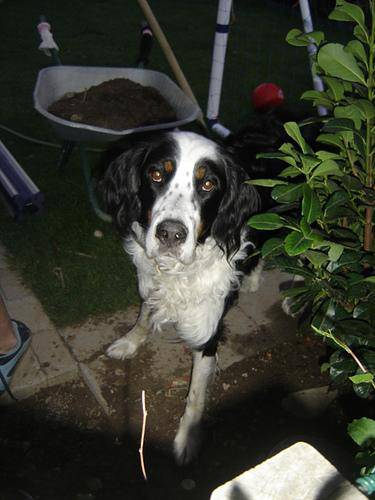

In [ ]:
# One more check

Image(filenames[2000])

In [ ]:
# Prepare our labels
import numpy as np
labels = label_csv["breed"]
labels

0                     boston_bull
1                           dingo
2                        pekinese
3                        bluetick
4                golden_retriever
                   ...           
10217                      borzoi
10218              dandie_dinmont
10219                    airedale
10220          miniature_pinscher
10221    chesapeake_bay_retriever
Name: breed, Length: 10222, dtype: object

In [ ]:
# Check number of labels matches to number of filenames
if len(labels) == len(filenames):
  print("Matches")
  print(f"Length of our labels: {len(labels)} and our filenames length: {len(filenames)}")
else:
  print("Not matches, Please check your directory")

Matches
Length of our labels: 10222 and our filenames length: 10222


In [ ]:
# Unique value of our labels
unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
len(unique_breeds)

120

In [ ]:
# Turn a single label into an array of booleans
labels[0] == unique_breeds

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# Turn every label into a boolean array
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:3]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

# Creating our validation set

We are using 1000 images for first experiment and increasing after

In [ ]:
# Setup X & y variables
X = filenames
y = boolean_labels

In [ ]:
# Set number of images to use for our experiment
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000}

In [ ]:
# Let's split our data into train and validation sets
from sklearn.model_selection import train_test_split

np.random.seed(42)

# Split them into training and validation set based on NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2)
len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [ ]:
X_train[:5], y_train[:5]

(['/content/drive/MyDrive/Dog-Vision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/MyDrive/Dog-Vision/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  '/content/drive/MyDrive/Dog-Vision/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  '/content/drive/MyDrive/Dog-Vision/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  '/content/drive/MyDrive/Dog-Vision/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         Fals

# Preprocessing images (turn images into Tensors)

Create a function for preprocessing our images, This function do these are:
1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, `image`
3. Turn our `image` (a jpg) into Tensors
4. Resize the `image` to be a shape of (224, 224)
5. Return the modified `image`

In [ ]:
# Try an example for preprocessing images
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [ ]:
image.max(), image.min()

(255, 0)

In [ ]:
# Turn image into Tensor
tf.constant(image)

<tf.Tensor: shape=(257, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  5

# This function to do these are:
1. Take an image filepath as an input
2. Use Tensorflow to read the file image and save it to variable, image
3. Turn our image (a jpg) into Tensors
4. Normalize our image (convert color channel values from 0-255 to 0-1)
5. Resize the image to be (224, 224) for shape
6. Return the modified image

In [ ]:
# Define image size
IMG_SIZE = 224

# Create a function for preprocessing images
def process_image(image_path, img_size=IMG_SIZE):
  """
  Takes  an image file path and turns the image into a Tensor.
  """

  # Read an image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 color channels (RGB)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the color channel value from 0-255 to 0-1 values (Normalize)
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to (224, 224) of the shape
  image = tf.image.resize(image, size=[img_size, img_size])

  return image


# Turning our data into batches

Turn our data into batches,  1 batch equals to 32 images

In [ ]:
# Create a function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and associated label,
  processes the image and returns a tuple of (image, label)
  """
  image = process_image(image_path)
  return image, label

In [ ]:
# Turn our data into batches
BATCH_SIZE = 32

# Create function for turning data
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Create batches of data image (X) and label (y) pairs.
  Shuffle data for training data, and dont shuffle if it's validation data,
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably dont have labels
  if test_data:
    print("Creating test data batches!")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # Only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data is a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating valid data batches!")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # Filepaths
                                              tf.constant(y))) # Labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches!")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                              tf.constant(y)))

    # Shuffling pathnames and labels before mapping
    data = data.shuffle(buffer_size=len(X))

    # Create (image, label) tuples
    data = data.map(get_image_label)

    # Turn the training data into batches
    data_batch = data.batch(BATCH_SIZE)

  return data_batch

In [ ]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches!
Creating valid data batches!


In [ ]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

# Visualizing Data Batches

In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_30_images(images, labels):
  """
  Display a plot of 30 images and their labels from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(15,15))
  # Loop through 30 times
  for i in range(30):
    # Create subplot 5 rows, 6 columns
    ax = plt.subplot(5, 6, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn the grid lines off
    plt.axis("off")

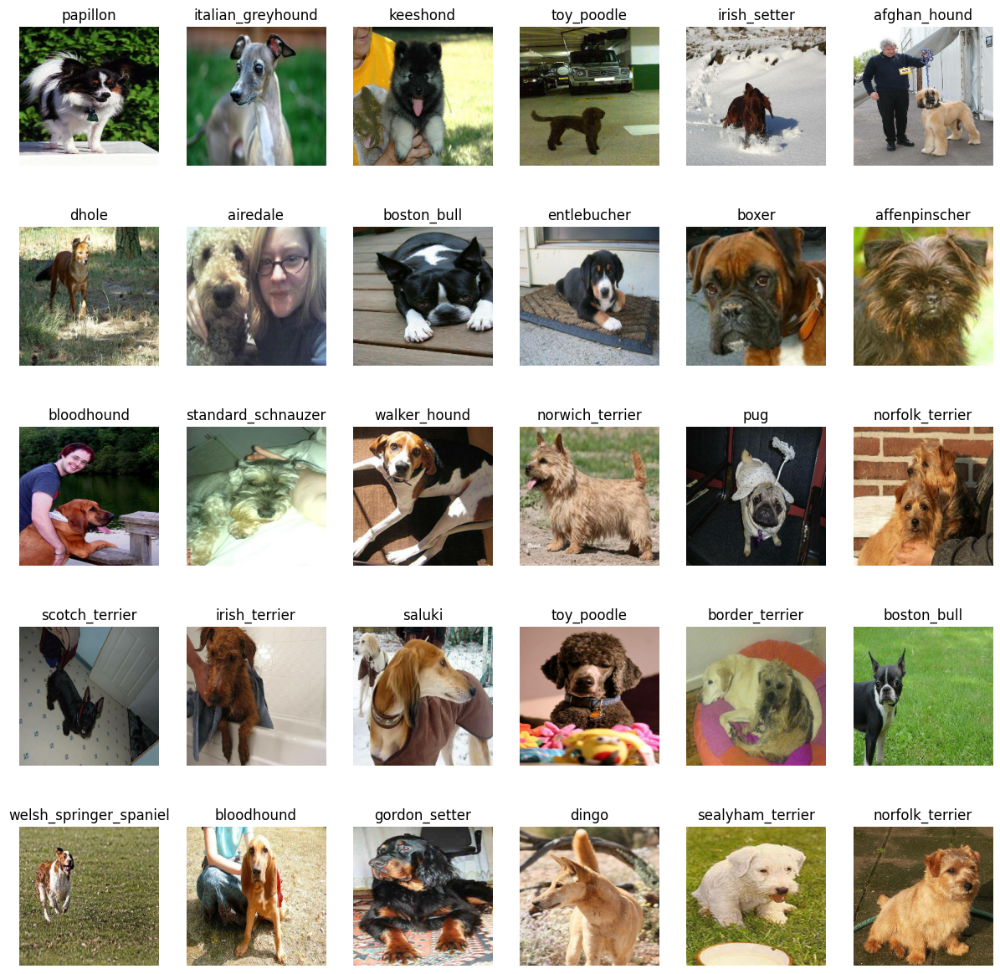

In [ ]:
# Now let's visualize the data in a training batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_30_images(train_images, train_labels)

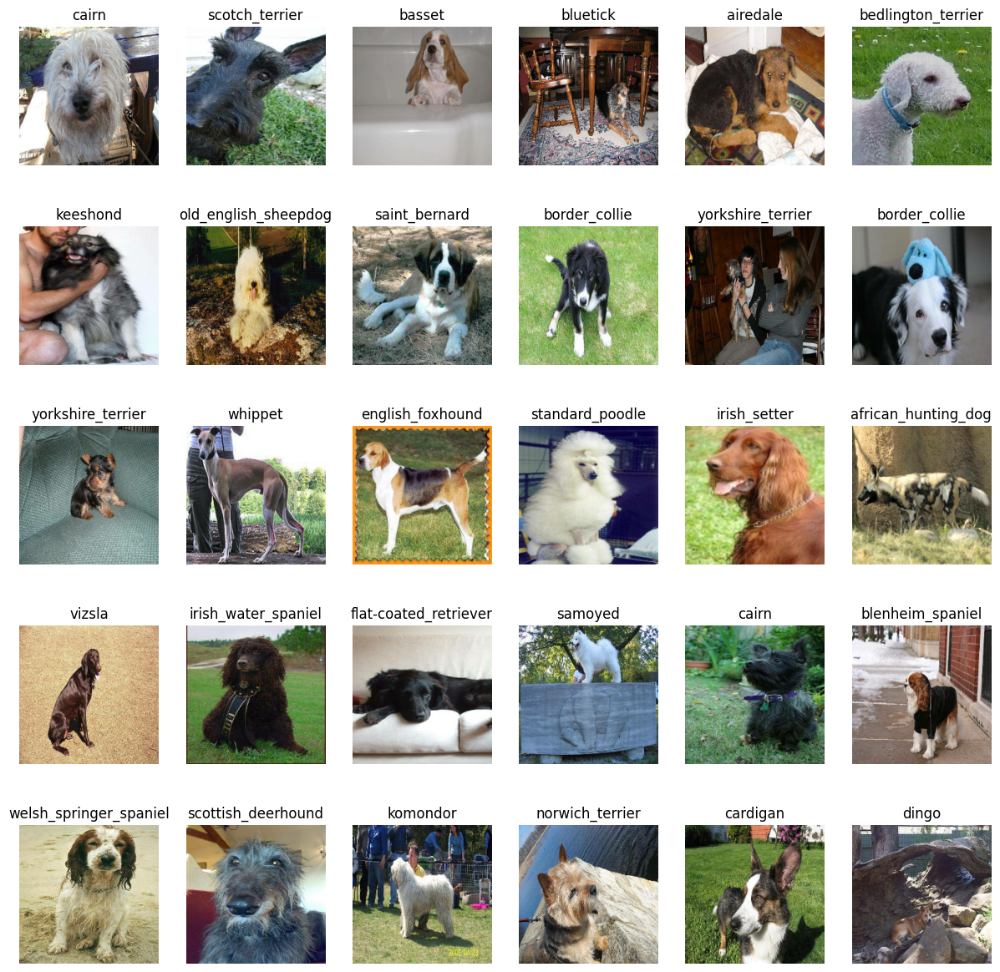

In [ ]:
# Visualize our validation set
val_images, val_labels = next(val_data.as_numpy_iterator())
show_30_images(val_images, val_labels)

In [ ]:
len(train_labels)

32

# Building a model

In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # Batch, height, width, color channels

# Setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds)

# Setup model URL from tensorflow hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"

In [ ]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE,
                 output_shape=OUTPUT_SHAPE,
                 model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
                                hub.KerasLayer(MODEL_URL),
                                tf.keras.layers.Dense(units=OUTPUT_SHAPE, #Input layer
                                                      activation="softmax") # Output layer
                              ])

  # Compile the model
  model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
                optimizer=tf.keras.optimizers.Adam(),
                metrics=["accuracy"]
                )
  # Build the model
  model.build(INPUT_SHAPE)

  return model

In [ ]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


# Creating Callbacks

## Tensorboard Callback

In [ ]:
# Load TensorBoard Notebook extension
%load_ext tensorboard

In [ ]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/MyDrive/dog_vision/logs",
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

## Early Stopping Callback

Early stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops.

In [ ]:
# Early Stopping Callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

# Training a model (on 1000 images)
Our baseline model is only going to train 1000 images, to make sure everything is working.

In [ ]:
NUM_EPOCHS = 100 #@param {type:"slider"}

In [ ]:
# Check to make sure we're still running on a GPU
print("GPU", "Available" if tf.config.list_physical_devices("GPU") else "Not Available.")

GPU Available


In [ ]:
# Build training function and return a trained model
def train_model():
  """
  Trains a given model and return the trained model.
  """

  # Create a model
  model = create_model()

  # Create new Tensorboard so we can monitor the training
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data and passing it the callback
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])

  return model

In [ ]:
# Fit the model
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
25/25 [==============================] - 142s 4s/step - loss: 4.5836 - accuracy: 0.1112 - val_loss: 3.4397 - val_accuracy: 0.2700
Epoch 2/100
25/25 [==============================] - 4s 172ms/step - loss: 1.6509 - accuracy: 0.6875 - val_loss: 2.1662 - val_accuracy: 0.4900
Epoch 3/100
25/25 [==============================] - 4s 171ms/step - loss: 0.5662 - accuracy: 0.9337 - val_loss: 1.6731 - val_accuracy: 0.5950
Epoch 4/100
25/25 [==============================] - 4s 144ms/step - loss: 0.2537 - accuracy: 0.9850 - val_loss: 1.4934 - val_accuracy: 0.6300
Epoch 5/100
25/25 [==============================] - 4s 162ms/step - loss: 0.1494 - accuracy: 0.9962 - val_loss: 1.4151 - val_accuracy: 0.6300
Epoch 6/100
25/25 [==============================] - 3s 127ms/step - loss: 0.1010 - accuracy: 0.9987 - val_loss: 1.3534 - val_accuracy: 0.6500
Epoch 7/100
25/25 [==============================]

# Try to handling overfitting


From the result above, This model is `overfitting`. So, try to some techniques to decrease the overfitting, These steps are here:
1. Increase a data from `1000` to `5000` and `10000` ✅
2. Try data augmentation ✅

In [ ]:
# Set number of data
NUM_IMAGES = 10000 #@param {type:"slider", min:5000, max:10000}

Creating training data batches!
Creating valid data batches!
Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_2 (KerasLayer)  (None, 1001)              5432713   
                                                                 
 dense_2 (Dense)             (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________
None
Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
250/250 [==============================] - 41s 144ms/step - loss: 1.5091 - accuracy: 0.6378 - val_loss: 0.7055 - val_accuracy: 0.7840
Epoch 2/100
250/250 [===============

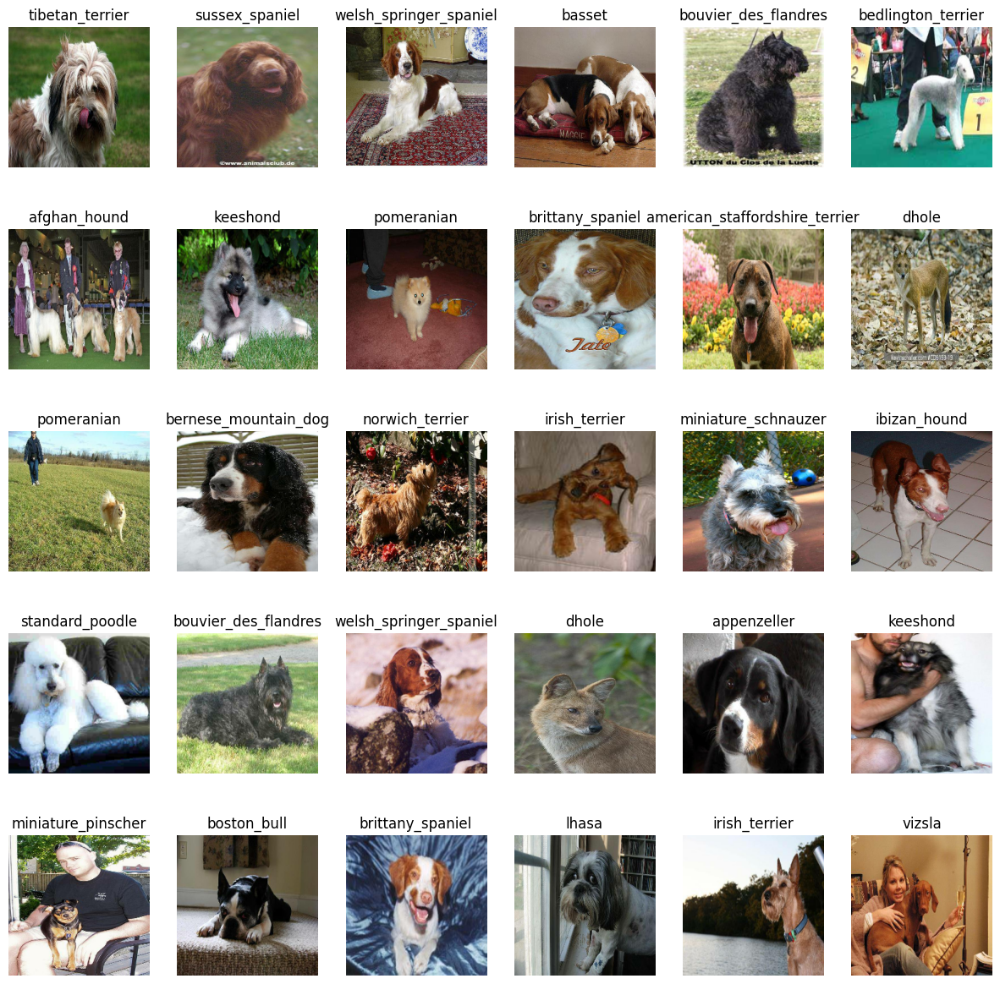

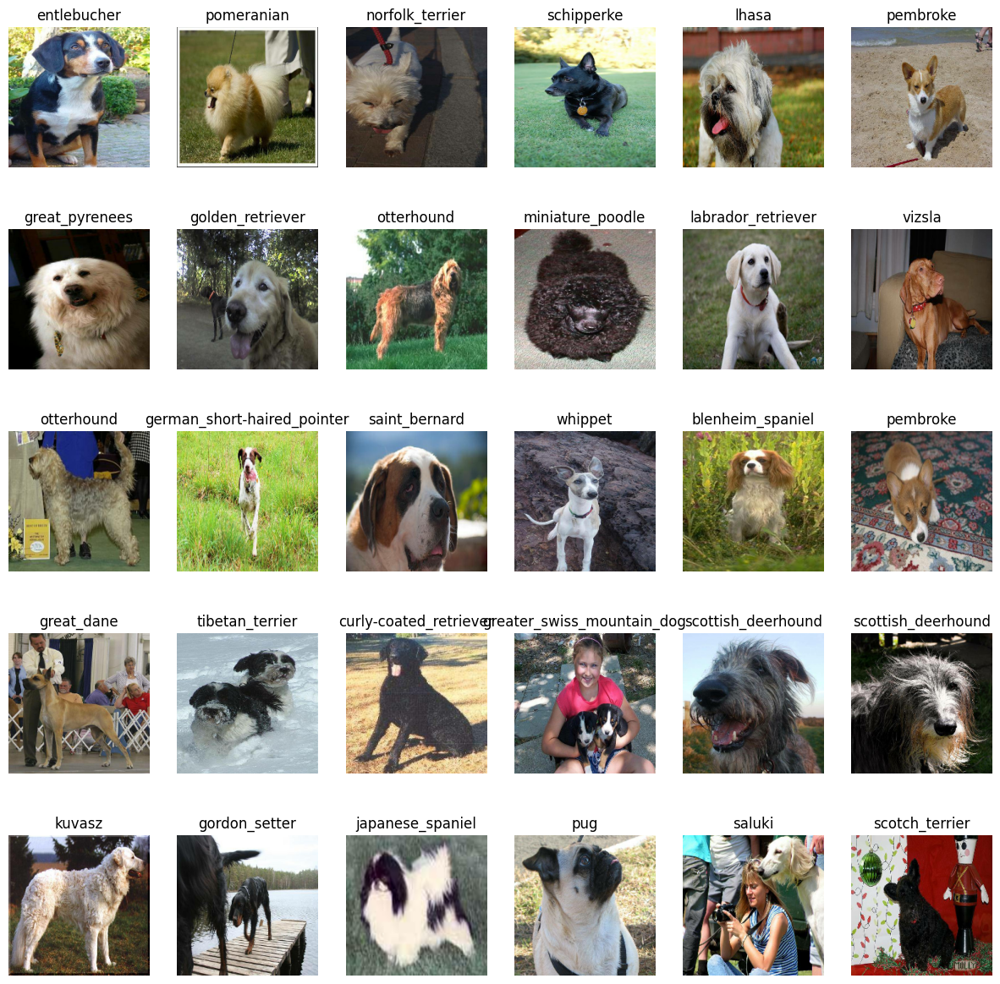

In [ ]:
# Split the data into train and validation sets again
np.random.seed(42)

X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2)
len(X_train), len(y_train), len(X_val), len(y_val)

# Preprocess the data and create batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

# Visualizing data in a training batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_30_images(train_images, train_labels)

# Visualizing data in validating batch
val_images, val_labels = next(val_data.as_numpy_iterator())
show_30_images(val_images, val_labels)

# Create a model
model = create_model()
print(model.summary())

# Train the model
model = train_model()

In [ ]:
%tensorboard --logdir drive/MyDrive/dog_vision/logs

<IPython.core.display.Javascript object>

# Data Augmentation
From above, the loss training and validation still have a big difference. So it can be assumed still overfitting. So to handle this overfitting, we can apply data augmentation to this model. Here is.

In [ ]:
# # Create directory for training and validating.
import os
import random
from sklearn.model_selection import train_test_split
import shutil


#  Set the directory path
dataset_dir = "/content/drive/MyDrive/Dog-Vision/train/"

# Create destination directory
train_dir = "/content/drive/MyDrive/Dog-Vision/train_dir/"
val_dir = "/content/drive/MyDrive/Dog-Vision/validation_dir/"
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)

# Get the list images in dataset directory
all_images = os.listdir(dataset_dir)

# Split the directory into training and validating sets
train_images, val_images = train_test_split(label_csv,
                                            test_size=0.2,
                                            random_state=42)
# Create class names
class_names = unique_breeds

# Create subdirectories in training directories for each class
for class_name in class_names:
  subdir_path = os.path.join(train_dir, class_name)
  subdir_path_val = os.path.join(val_dir, class_name)
  os.makedirs(subdir_path, exist_ok=True)
  os.makedirs(subdir_path_val, exist_ok=True)

# Move images from dataset directory to training directiory
iter = 0
# Training images
for index, column in train_images.iterrows():
  print(f"Iteratsi : {iter}")
  if column["breed"] in class_names:
    label = column["breed"]
    image = column["id"] + ".jpg"
    src_path = os.path.join(dataset_dir, image)
    dst_path = os.path.join(train_dir + str(label), image)
    shutil.copy(src_path, dst_path)
  iter += 1

# Move images from dataset directory to validating directiory
for index, column in val_images.iterrows():
  print(f"Iterassi : {iter}")
  if column["breed"] in class_names:
    label = column["breed"]
    image = column["id"] + ".jpg"
    src_path = os.path.join(dataset_dir, image)
    dst_path = os.path.join(val_dir + str(label), image)
    shutil.copy(src_path, dst_path)
  iter += 1

Streaming output truncated to the last 5000 lines.
Iteratsi : 5222
Iteratsi : 5223
Iteratsi : 5224
Iteratsi : 5225
Iteratsi : 5226
Iteratsi : 5227
Iteratsi : 5228
Iteratsi : 5229
Iteratsi : 5230
Iteratsi : 5231
Iteratsi : 5232
Iteratsi : 5233
Iteratsi : 5234
Iteratsi : 5235
Iteratsi : 5236
Iteratsi : 5237
Iteratsi : 5238
Iteratsi : 5239
Iteratsi : 5240
Iteratsi : 5241
Iteratsi : 5242
Iteratsi : 5243
Iteratsi : 5244
Iteratsi : 5245
Iteratsi : 5246
Iteratsi : 5247
Iteratsi : 5248
Iteratsi : 5249
Iteratsi : 5250
Iteratsi : 5251
Iteratsi : 5252
Iteratsi : 5253
Iteratsi : 5254
Iteratsi : 5255
Iteratsi : 5256
Iteratsi : 5257
Iteratsi : 5258
Iteratsi : 5259
Iteratsi : 5260
Iteratsi : 5261
Iteratsi : 5262
Iteratsi : 5263
Iteratsi : 5264
Iteratsi : 5265
Iteratsi : 5266
Iteratsi : 5267
Iteratsi : 5268
Iteratsi : 5269
Iteratsi : 5270
Iteratsi : 5271
Iteratsi : 5272
Iteratsi : 5273
Iteratsi : 5274
Iteratsi : 5275
Iteratsi : 5276
Iteratsi : 5277
Iteratsi : 5278
Iteratsi : 5279
Iteratsi : 5280
Itera

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator


# Adding rescale, rotation_range, width_shift_range, height_shift_range,
# shear_range, zoom_range, and horizontal flip to our ImageDataGenerator

train_datagen = ImageDataGenerator(
                              rescale=1./255,
                              rotation_range=60,
                              width_shift_range=0.2,
                              height_shift_range=0.2,
                              shear_range=0.1,
                              zoom_range=0.1,
                              horizontal_flip=True,
                            )

# Validation data should not be augmented.
val_datagen = ImageDataGenerator(rescale=1./255)

# Flow training images in batches of 32 using train_datagen generator
train_augmented  = train_datagen.flow_from_directory(
            directory=train_dir,
            target_size=(224,224),
            batch_size=32,
            # This is multiclass, so use CategoricalCrossEntropy loss
            class_mode='categorical'
)

val_non_aug = val_datagen.flow_from_directory(
            directory=val_dir,
            target_size=(224, 224),
            batch_size=32,
            class_mode='categorical'
)

# Create the model
model = create_model()

# Create tensorboard
augmented_tensorboard = create_tensorboard_callback()

# Fit the model
model.fit(train_augmented,
          validation_data=val_non_aug,
          steps_per_epoch=len(train_augmented),
          validation_steps=len(val_non_aug),
          epochs=NUM_EPOCHS,
          validation_freq=1,
          callbacks=[augmented_tensorboard, early_stopping])

Found 8177 images belonging to 120 classes.
Found 2045 images belonging to 120 classes.
Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
256/256 [==============================] - 154s 582ms/step - loss: 2.4260 - accuracy: 0.4299 - val_loss: 0.9647 - val_accuracy: 0.7257
Epoch 2/100
256/256 [==============================] - 149s 582ms/step - loss: 1.2265 - accuracy: 0.6592 - val_loss: 0.8335 - val_accuracy: 0.7570
Epoch 3/100
256/256 [==============================] - 149s 583ms/step - loss: 1.0276 - accuracy: 0.6994 - val_loss: 0.8198 - val_accuracy: 0.7570
Epoch 4/100
256/256 [==============================] - 149s 582ms/step - loss: 0.9222 - accuracy: 0.7232 - val_loss: 0.8035 - val_accuracy: 0.7570
Epoch 5/100
256/256 [==============================] - 148s 578ms/step - loss: 0.8498 - accuracy: 0.7409 - val_loss: 0.8239 - val_accuracy: 0.7540


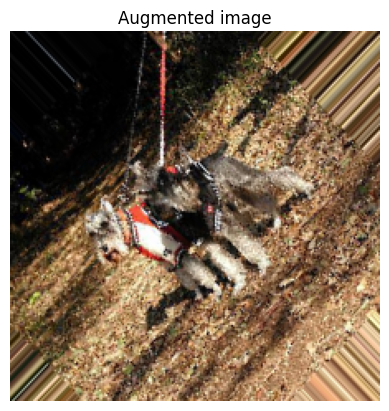

In [ ]:
# Show the augmented image
augmented_train_images, augmented_label_images = train_augmented.next()
random_number = random.randint(0, 32)
plt.imshow(augmented_train_images[random_number])
plt.title(f"Augmented image")
plt.axis(False);

# Checking tensorboard logs

In [ ]:
%tensorboard --logdir drive/MyDrive/dog_vision/logs

<IPython.core.display.Javascript object>

# Making and evaluating predictions using a trained model  and augmented data

In [ ]:
# Show validation images  and labels
val_images, val_labels = val_non_aug.next()
val_images

array([[[[0.19215688, 0.2784314 , 0.27058825],
         [0.15686275, 0.24313727, 0.23529413],
         [0.18823531, 0.27450982, 0.26666668],
         ...,
         [0.16470589, 0.227451  , 0.227451  ],
         [0.20784315, 0.27058825, 0.26666668],
         [0.21960786, 0.28235295, 0.27058825]],

        [[0.16078432, 0.24705884, 0.2392157 ],
         [0.10196079, 0.18823531, 0.18039216],
         [0.09803922, 0.18431373, 0.1764706 ],
         ...,
         [0.07058824, 0.13333334, 0.12941177],
         [0.09803922, 0.16078432, 0.15686275],
         [0.1137255 , 0.1764706 , 0.16470589]],

        [[0.18431373, 0.2627451 , 0.25882354],
         [0.10980393, 0.18823531, 0.18431373],
         [0.08627451, 0.16470589, 0.16078432],
         ...,
         [0.0509804 , 0.1137255 , 0.10196079],
         [0.09019608, 0.15294118, 0.14117648],
         [0.11764707, 0.18039216, 0.16862746]],

        ...,

        [[0.59607846, 0.58431375, 0.37647063],
         [0.5372549 , 0.53333336, 0.32156864]

In [ ]:
predictions = model.predict(val_images)
predictions

1/1 [==============================] - 0s 49ms/step


# Making predictions on the test dataset

In [ ]:
# Load test image filenames
test_path = "/content/drive/MyDrive/Dog-Vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['/content/drive/MyDrive/Dog-Vision/test/e6c9d8058cbc9b1665aecac1ae179288.jpg',
 '/content/drive/MyDrive/Dog-Vision/test/e22d81ccf32bd590d8dd66815fd222b7.jpg',
 '/content/drive/MyDrive/Dog-Vision/test/e2b6d4957b62934bd831c3a1b65e2ebb.jpg',
 '/content/drive/MyDrive/Dog-Vision/test/e721c3eec5951861bf3ed7f40ef8b091.jpg',
 '/content/drive/MyDrive/Dog-Vision/test/df2a003a0b1a216effd806f03f703859.jpg',
 '/content/drive/MyDrive/Dog-Vision/test/e1f9be3ecf0409189486c786ff4bd65a.jpg',
 '/content/drive/MyDrive/Dog-Vision/test/e57820007fcc2a07a5230177965a0f59.jpg',
 '/content/drive/MyDrive/Dog-Vision/test/deb063345bf2b6752e2fe25cad096547.jpg',
 '/content/drive/MyDrive/Dog-Vision/test/e6a5c18da7beedb1622bf7d18b452121.jpg',
 '/content/drive/MyDrive/Dog-Vision/test/e7afcce6e45858fc3b294cc5c0b15a53.jpg']

In [ ]:
len(test_filenames)

10357

In [ ]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches!


In [ ]:
test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [ ]:
# Make prediction on test data batch using model that have been trained with augmented data
test_predictions = model.predict(test_data,
                                 verbose=1)

324/324 [==============================] - 178s 529ms/step


In [ ]:
# Save predictions (NumPy array) to csv file (for access later)
np.savetxt("/content/drive/MyDrive/dog_vision/preds_array.csv", test_predictions, delimiter=",")

In [ ]:
# Load predictions (NumPy array) from csv file
test_predictions = np.loadtxt("/content/drive/MyDrive/dog_vision/preds_array.csv", delimiter=",")

In [ ]:
test_predictions[:10]

array([[2.58084327e-07, 1.34831180e-06, 8.98589860e-07, ...,
        9.25774002e-05, 1.73061437e-06, 3.84324153e-07],
       [1.29597220e-06, 2.30574273e-07, 7.52801554e-07, ...,
        4.41625489e-05, 2.27350192e-08, 1.97463024e-09],
       [3.05157840e-07, 2.03250856e-05, 1.27213025e-06, ...,
        1.40313182e-06, 1.55724166e-07, 1.38646016e-07],
       ...,
       [7.94454012e-04, 6.45901537e-08, 1.81721953e-06, ...,
        1.56785859e-07, 2.21763021e-05, 6.86995743e-04],
       [1.11297322e-05, 5.02450421e-05, 2.19236631e-06, ...,
        2.76341689e-06, 6.12898191e-07, 4.35430275e-06],
       [9.46988106e-01, 1.61856569e-05, 2.02123329e-06, ...,
        1.88254987e-07, 1.80559141e-06, 6.73324030e-05]])

In [ ]:
# ["id"] + list(unique_breeds)

['id',
 'affenpinscher',
 'afghan_hound',
 'african_hunting_dog',
 'airedale',
 'american_staffordshire_terrier',
 'appenzeller',
 'australian_terrier',
 'basenji',
 'basset',
 'beagle',
 'bedlington_terrier',
 'bernese_mountain_dog',
 'black-and-tan_coonhound',
 'blenheim_spaniel',
 'bloodhound',
 'bluetick',
 'border_collie',
 'border_terrier',
 'borzoi',
 'boston_bull',
 'bouvier_des_flandres',
 'boxer',
 'brabancon_griffon',
 'briard',
 'brittany_spaniel',
 'bull_mastiff',
 'cairn',
 'cardigan',
 'chesapeake_bay_retriever',
 'chihuahua',
 'chow',
 'clumber',
 'cocker_spaniel',
 'collie',
 'curly-coated_retriever',
 'dandie_dinmont',
 'dhole',
 'dingo',
 'doberman',
 'english_foxhound',
 'english_setter',
 'english_springer',
 'entlebucher',
 'eskimo_dog',
 'flat-coated_retriever',
 'french_bulldog',
 'german_shepherd',
 'german_short-haired_pointer',
 'giant_schnauzer',
 'golden_retriever',
 'gordon_setter',
 'great_dane',
 'great_pyrenees',
 'greater_swiss_mountain_dog',
 'groenen

In [ ]:
# Create a pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
# Append test image id's to predictions DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df["id"] = test_ids
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e6c9d8058cbc9b1665aecac1ae179288,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e22d81ccf32bd590d8dd66815fd222b7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e2b6d4957b62934bd831c3a1b65e2ebb,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e721c3eec5951861bf3ed7f40ef8b091,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,df2a003a0b1a216effd806f03f703859,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
[os.path.splitext(path)[0] for path in os.listdir(test_path)]

['e6c9d8058cbc9b1665aecac1ae179288',
 'e22d81ccf32bd590d8dd66815fd222b7',
 'e2b6d4957b62934bd831c3a1b65e2ebb',
 'e721c3eec5951861bf3ed7f40ef8b091',
 'df2a003a0b1a216effd806f03f703859',
 'e1f9be3ecf0409189486c786ff4bd65a',
 'e57820007fcc2a07a5230177965a0f59',
 'deb063345bf2b6752e2fe25cad096547',
 'e6a5c18da7beedb1622bf7d18b452121',
 'e7afcce6e45858fc3b294cc5c0b15a53',
 'e7be7b911a4cba9fdfa4105ec4776370',
 'efac70ee513c40265966b89d715f183e',
 'ed63374c99282b3081705ed84a2b93bc',
 'eb8473f9fc102c45e0c0abd07de20a2a',
 'ed61910363f37890c8cc47b25836f82e',
 'eb48e06416db42a71d5c232191fec3a0',
 'e924a899e6de9df57c3a95873640f2bd',
 'f195789502ac83352770c6718ba9eaa2',
 'f18e43d6627bf395c2e3aae518067004',
 'f21691cb46f6d593ec77a7a0000c4454',
 'eb8e9637c329ca7ad7937be0ec94e80d',
 'ea5bd02a78f243c609cd227c4a09c6c4',
 'f1040b51b35ad34a0d35068af4e9cc2f',
 'ece4530999e8c3ec85d2a86d33f07e37',
 'f5a6e430c2c363335d22ae0593d7533a',
 'edd77b60eb22df1021e726b87c270064',
 'ed0ec7befaa38726a118ab7e4d53b332',
 

In [ ]:
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e6c9d8058cbc9b1665aecac1ae179288,2.580843e-07,1.348312e-06,8.985899e-07,9.016489e-08,5.159101e-05,2.076664e-04,5.023405e-07,1.113748e-05,3.832850e-09,...,6.598165e-08,3.597172e-08,1.205377e-06,2.810127e-07,6.293272e-09,1.290460e-07,1.343621e-06,9.257740e-05,1.730614e-06,3.843242e-07
1,e22d81ccf32bd590d8dd66815fd222b7,1.295972e-06,2.305743e-07,7.528016e-07,1.369173e-08,5.123817e-06,1.289286e-06,3.258797e-08,3.079751e-05,1.084854e-07,...,6.211240e-08,1.309498e-05,6.460125e-07,2.594046e-07,7.409177e-05,7.708836e-09,2.464326e-06,4.416255e-05,2.273502e-08,1.974630e-09
2,e2b6d4957b62934bd831c3a1b65e2ebb,3.051578e-07,2.032509e-05,1.272130e-06,4.781400e-06,4.425271e-07,5.614947e-08,2.056330e-09,3.954368e-09,8.190664e-09,...,4.558401e-07,3.008106e-09,1.022567e-08,7.619254e-08,1.137654e-07,4.311070e-08,9.239242e-08,1.403132e-06,1.557242e-07,1.386460e-07
3,e721c3eec5951861bf3ed7f40ef8b091,3.939762e-06,3.708489e-05,2.405248e-06,1.162425e-06,1.658037e-06,1.506544e-06,8.819132e-08,1.046340e-06,7.161590e-07,...,4.541453e-05,6.553889e-07,1.754230e-05,7.953587e-05,1.346544e-05,1.054798e-05,2.494859e-06,4.001688e-07,4.156060e-07,2.816029e-08
4,df2a003a0b1a216effd806f03f703859,1.420312e-06,6.077263e-04,7.529537e-07,1.090239e-06,4.617972e-08,6.019915e-05,3.735970e-08,3.251166e-07,9.151028e-06,...,4.223226e-06,3.802127e-08,4.692988e-07,2.826298e-05,1.353049e-06,2.800419e-06,5.126910e-08,8.088729e-09,1.127570e-06,1.254914e-07


In [ ]:
# Save our predictions dataframe to CSV for submission to Kaggle
preds_df.to_csv("drive/MyDrive/dog_vision_full_model_predictions_submission_2_mobilenetV2.csv",
                index=False)